# Image Captioning Embedding Extraction 

Co-authored-by: Leila Abdelrahman , Tom Jin and the TensorFlow Team



This code reads in extracted frames and captions them. It saves a checkpoint of the model for future use.

TODO: Train on the remaining 50k images.

## Get Library Packages

In [ ]:
!pip install --user -U nltk

     |████████████████████████████████| 1.4MB 2.8MB/s 
  Created wheel for nltk: filename=nltk-3.5-cp36-none-any.whl size=1434674 sha256=d161572391818165e81cec9ef8593b825209f2caa2523cadf6f7650717d85699
  Stored in directory: /root/.cache/pip/wheels/ae/8c/3f/b1fe0ba04555b08b57ab52ab7f86023639a526d8bc8d384306
Successfully built nltk
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


You need to enter "punkt" as the Identifier

In [ ]:
import nltk
nltk.download()

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> d

Download which package (l=list; x=cancel)?
  Identifier> punkt
      Unzipping tokenizers/punkt.zip.

---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> q


True

# Image Captioning Portion Pre-Training

Pretraining with the MS COCO Class. This code is heavily based on the pretrained im2txt Show and Tell Model: https://github.com/tensorflow/models/tree/master/research/im2txt


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
!cp 'drive/My Drive/Machine-Learning-Projects/cs231n-project/models/image_capt_container.zip' .

In [ ]:
!unzip image_capt_container.zip

Archive:  image_capt_container.zip
  inflating: model.ckpt-2000000      
  inflating: graph.pbtxt             
   creating: im2txt/
  inflating: im2txt/evaluate.py      
  inflating: im2txt/inference_wrapper.py  
  inflating: im2txt/show_and_tell_model.py  
  inflating: im2txt/train.py         
   creating: im2txt/ops/
   creating: im2txt/ops/__pycache__/
  inflating: im2txt/ops/__pycache__/image_processing.cpython-36.pyc  
  inflating: im2txt/ops/__pycache__/inputs.cpython-36.pyc  
  inflating: im2txt/ops/__pycache__/image_embedding.cpython-36.pyc  
  inflating: im2txt/ops/BUILD        
  inflating: im2txt/ops/image_processing.py  
  inflating: im2txt/ops/image_embedding_test.py  
  inflating: im2txt/ops/inputs.py    
  inflating: im2txt/ops/image_embedding.py  
   creating: im2txt/__pycache__/
  inflating: im2txt/__pycache__/inference_wrapper.cpython-36.pyc  
  inflating: im2txt/__pycache__/show_and_tell_model.cpython-36.pyc  
  inflating: im2txt/__pycache__/configuration.cpython-36.

In [ ]:
# Location to save the Inception v3 checkpoint.
!INCEPTION_DIR="${HOME}/im2txt/data" ; mkdir -p ${INCEPTION_DIR} ; wget "http://download.tensorflow.org/models/inception_v3_2016_08_28.tar.gz" ;tar -xvf "inception_v3_2016_08_28.tar.gz" -C ${INCEPTION_DIR} ; rm "inception_v3_2016_08_28.tar.gz"

--2020-06-18 00:26:13--  http://download.tensorflow.org/models/inception_v3_2016_08_28.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 64.233.189.128, 2404:6800:4008:c07::80
Connecting to download.tensorflow.org (download.tensorflow.org)|64.233.189.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 100885009 (96M) [application/x-tar]
Saving to: ‘inception_v3_2016_08_28.tar.gz’

inception_v3_2016_0 100%[===================>]  96.21M   330MB/s    in 0.3s    

2020-06-18 00:26:13 (330 MB/s) - ‘inception_v3_2016_08_28.tar.gz’ saved [100885009/100885009]

inception_v3.ckpt


## Get the Data 

In [ ]:
!cp '/content/drive/My Drive/Machine-Learning-Projects/cs231n-project/datasets/emotiw/train_frames.tar.gz' .
#!cp '/content/drive/My Drive/cs231n-project/datasets/emotiw/train_frames.tar.gz' .

^C


In [ ]:
!tar -xzf train_frames.tar.gz

In [ ]:
!cp '/content/drive/My Drive/Machine-Learning-Projects/cs231n-project/datasets/emotiw/val_frames.tar.gz' .
#!cp '/content/drive/My Drive/cs231n-project/datasets/emotiw/val_frames.tar.gz' .

!tar -xzf val_frames.tar.gz

In [ ]:
!ls val_frames/1 | head

frame_11_10.mp4_0.jpg
frame_11_10.mp4_10.jpg
frame_11_10.mp4_11.jpg
frame_11_10.mp4_12.jpg
frame_11_10.mp4_13.jpg
frame_11_10.mp4_14.jpg
frame_11_10.mp4_1.jpg
frame_11_10.mp4_2.jpg
frame_11_10.mp4_3.jpg
frame_11_10.mp4_4.jpg


In [ ]:
# #!wget 'https://github.com/tensorflow/models/raw/master/research/im2txt/g3doc/COCO_val2014_000000224477.jpg'
# !wget https://storage.googleapis.com/cs231n-emotiw/models/im2txt_2016_10_11.2000000.tar.gz

--2020-06-17 23:39:23--  https://storage.googleapis.com/cs231n-emotiw/models/im2txt_2016_10_11.2000000.tar.gz
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.201.128, 2607:f8b0:4001:c07::80
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.201.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 139264353 (133M) [application/gzip]
Saving to: ‘im2txt_2016_10_11.2000000.tar.gz’

im2txt_2016_10_11.2 100%[===================>] 132.81M  72.1MB/s    in 1.8s    

2020-06-17 23:39:26 (72.1 MB/s) - ‘im2txt_2016_10_11.2000000.tar.gz’ saved [139264353/139264353]



### WARNING: YOU MUST USE TF <2.0

In [ ]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [ ]:
from run_inference import get_captions

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [ ]:
# !unzip /content/image-capt-container/image_capt_container.zip

Archive:  /content/image-capt-container/image_capt_container.zip
replace model.ckpt-2000000? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: model.ckpt-2000000      
  inflating: graph.pbtxt             
  inflating: im2txt/evaluate.py      
  inflating: im2txt/inference_wrapper.py  
  inflating: im2txt/show_and_tell_model.py  
  inflating: im2txt/train.py         
  inflating: im2txt/ops/__pycache__/image_processing.cpython-36.pyc  
  inflating: im2txt/ops/__pycache__/inputs.cpython-36.pyc  
  inflating: im2txt/ops/__pycache__/image_embedding.cpython-36.pyc  
  inflating: im2txt/ops/BUILD        
  inflating: im2txt/ops/image_processing.py  
  inflating: im2txt/ops/image_embedding_test.py  
  inflating: im2txt/ops/inputs.py    
  inflating: im2txt/ops/image_embedding.py  
  inflating: im2txt/__pycache__/inference_wrapper.cpython-36.pyc  
  inflating: im2txt/__pycache__/show_and_tell_model.cpython-36.pyc  
  inflating: im2txt/__pycache__/configuration.cpython-36.pyc  
  inflating:

In [ ]:
captions , log_prob = get_captions(checkpoint_path='/content/model.ckpt-2000000' , vocab_path='/content/word_counts_new.txt' , image_path='/content/ep271.jpg' )

INFO:tensorflow:Building model.
INFO:tensorflow:Initializing vocabulary from file: /content/word_counts_new.txt
INFO:tensorflow:Created vocabulary with 11520 words
INFO:tensorflow:Running caption generation on 1 files matching /content/ep271.jpg
INFO:tensorflow:Loading model from checkpoint: /content/model.ckpt-2000000
INFO:tensorflow:Restoring parameters from /content/model.ckpt-2000000
INFO:tensorflow:Successfully loaded checkpoint: model.ckpt-2000000


In [ ]:
print(captions)

['a woman is standing next to a horse .', 'a woman is standing next to a horse', 'a woman is standing next to a brown horse .']


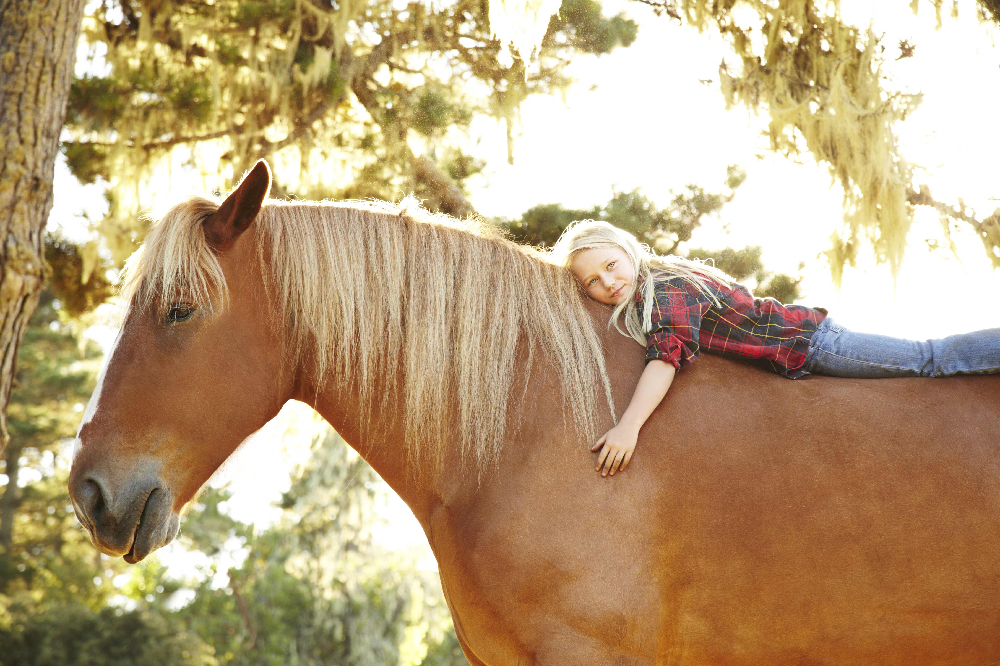

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
image = cv2.imread('/content/ep271.jpg')
cv2_imshow(image)